<a href="https://colab.research.google.com/github/Guru-180188/Projects/blob/main/Anime_DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!mkdir -p ~/ .kaggle

In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 /root/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d soumikrakshit/anime-faces

 95% 417M/441M [00:03<00:00, 76.6MB/s]
100% 441M/441M [00:03<00:00, 143MB/s] 


In [ ]:
import zipfile
zip_ref = zipfile.ZipFile('/content/anime-faces.zip', 'r')
zip_ref.extractall('/content')
zip_ref.close()

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [ ]:
BASE_DIR ="/content/data/data"

In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:10]

['/content/data/data/9212.png',
 '/content/data/data/1548.png',
 '/content/data/data/21089.png',
 '/content/data/data/13225.png',
 '/content/data/data/5163.png',
 '/content/data/data/3455.png',
 '/content/data/data/16982.png',
 '/content/data/data/10775.png',
 '/content/data/data/17495.png',
 '/content/data/data/13540.png']

In [ ]:
# remove unnecessary file
if '/content/data' in image_paths:
    image_paths.remove('/content/data/data')

In [ ]:
len(image_paths)

21551

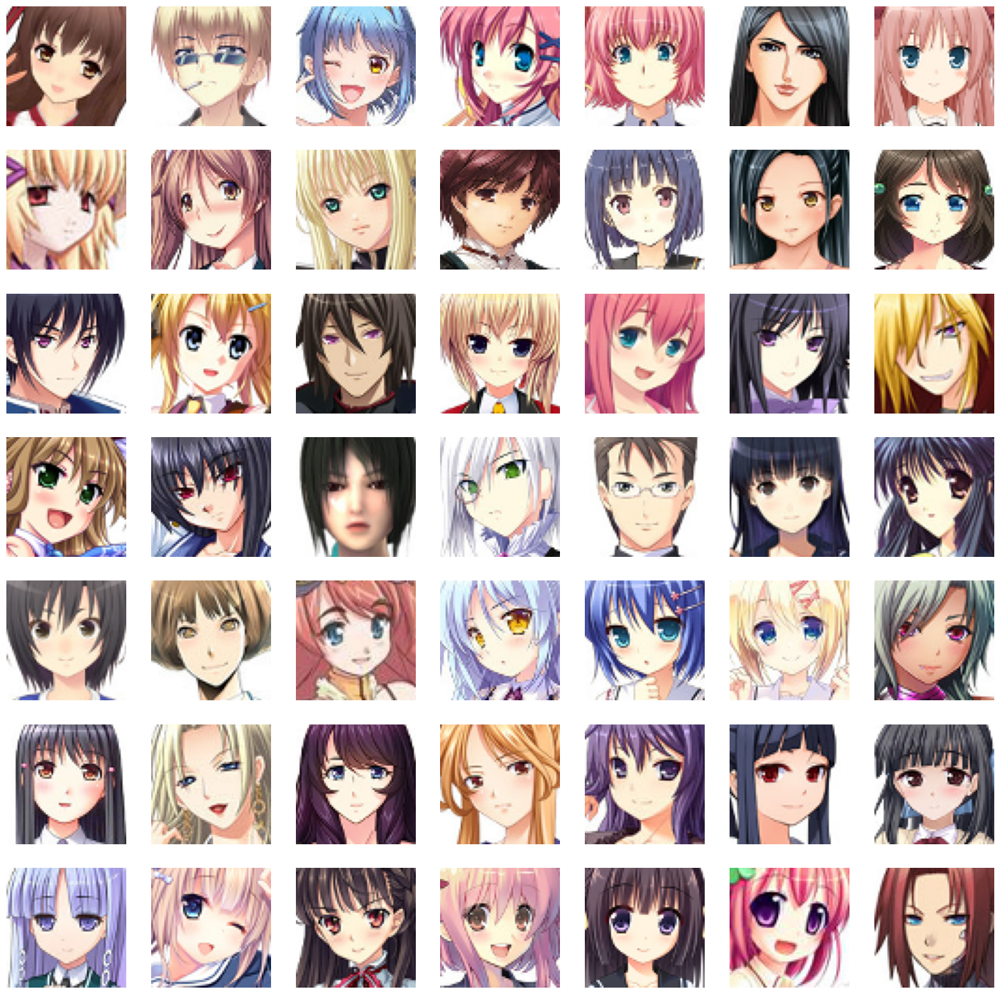

In [ ]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

In [ ]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[ 0.99215686,  0.94509804,  0.96862745],
        [ 0.9764706 ,  1.        ,  0.9843137 ],
        [ 0.8039216 ,  0.9137255 ,  0.827451  ],
        ...,
        [-0.01176471, -0.35686275, -0.44313726],
        [ 0.1764706 , -0.16862746, -0.23137255],
        [ 0.16862746, -0.1764706 , -0.24705882]],

       [[ 0.9529412 ,  0.9607843 ,  0.9607843 ],
        [ 1.        ,  1.        ,  1.        ],
        [-0.2784314 , -0.2784314 , -0.3882353 ],
        ...,
        [-0.04313726, -0.3882353 , -0.4745098 ],
        [ 0.11372549, -0.23137255, -0.3019608 ],
        [ 0.16862746, -0.16862746, -0.23921569]],

       [[ 0.96862745,  1.        ,  0.99215686],
        [ 0.43529412,  0.42745098,  0.41960785],
        [-0.27058825, -0.8352941 , -0.8039216 ],
        ...,
        [-0.03529412, -0.38039216, -0.46666667],
        [ 0.06666667, -0.2784314 , -0.34901962],
        [ 0.16862746, -0.1764706 , -0.24705882]],

       ...,

       [[-0.15294118, -0.8745098 , -0.84313726],
        [-0

In [ ]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In [ ]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 256)       2097408   
 anspose)                                                        
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 32, 32, 128)       524416    
 Transpose)                                              

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (Batch  (None, 32, 32, 64)        256       
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/25
674/674 [==============================] - ETA: 0s - d_loss: 0.6935 - g_loss: 2.6161

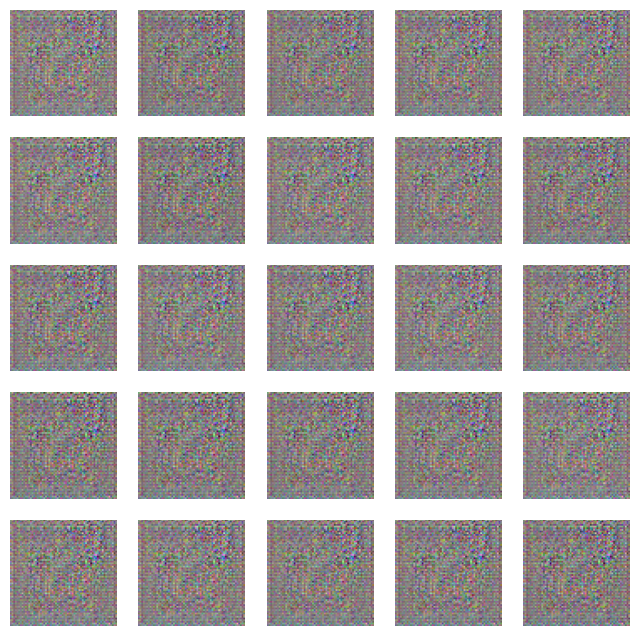

674/674 [==============================] - 57s 66ms/step - d_loss: 0.6935 - g_loss: 2.6161
Epoch 2/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.4243 - g_loss: 2.3374

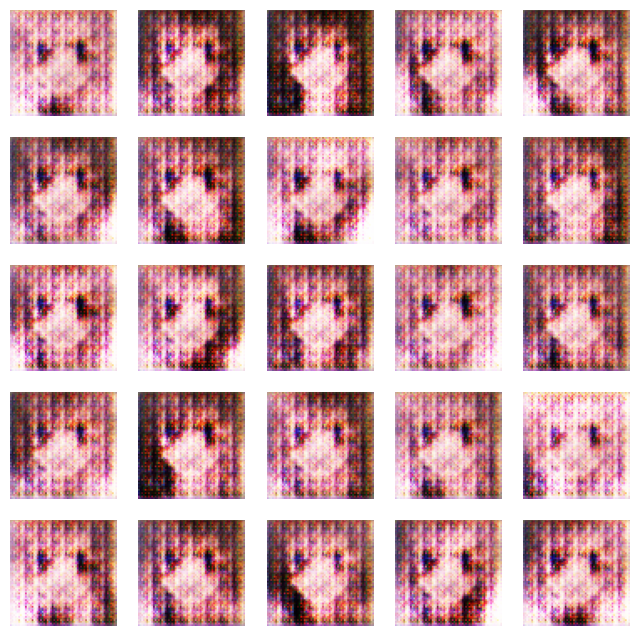

674/674 [==============================] - 45s 67ms/step - d_loss: 0.4246 - g_loss: 2.3362
Epoch 3/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.5622 - g_loss: 1.8299

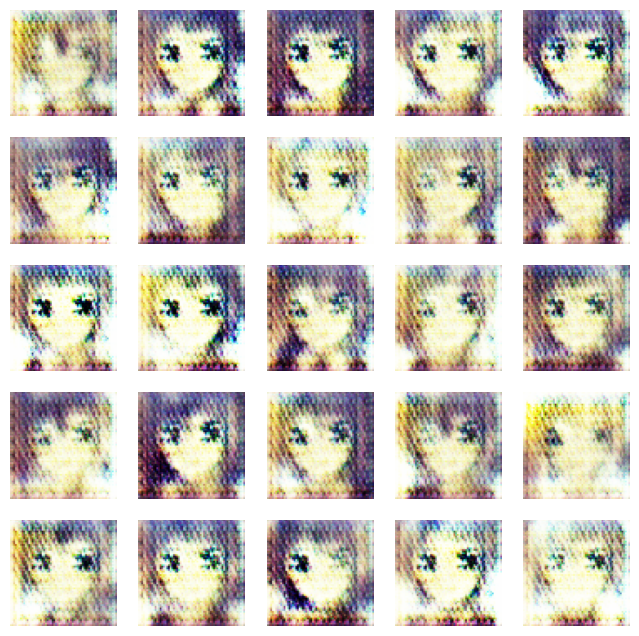

674/674 [==============================] - 45s 67ms/step - d_loss: 0.5623 - g_loss: 1.8296
Epoch 4/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.5625 - g_loss: 1.8313

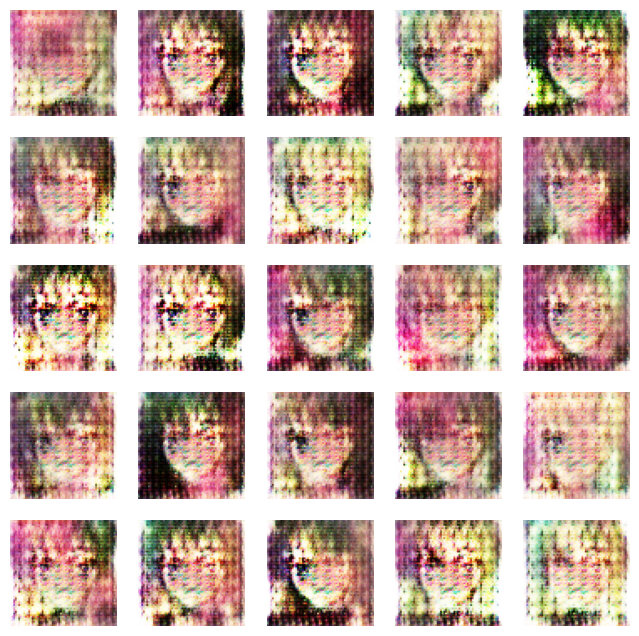

674/674 [==============================] - 46s 69ms/step - d_loss: 0.5622 - g_loss: 1.8317
Epoch 5/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.5486 - g_loss: 1.8465

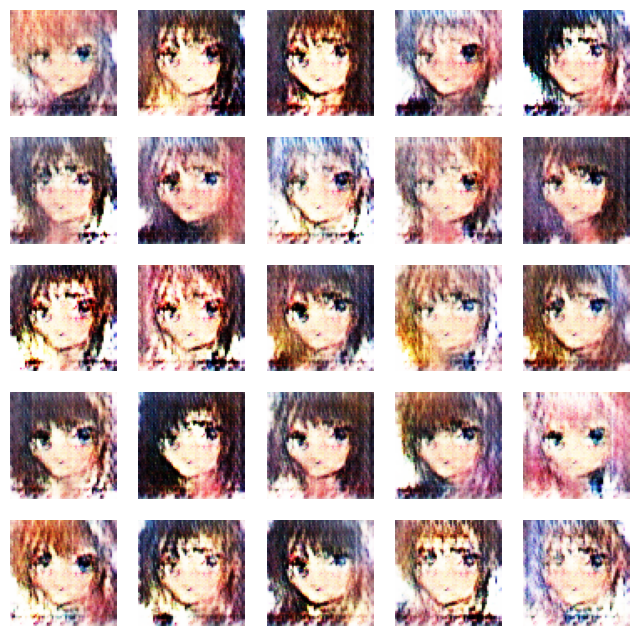

674/674 [==============================] - 47s 69ms/step - d_loss: 0.5484 - g_loss: 1.8469
Epoch 6/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.5714 - g_loss: 1.6219

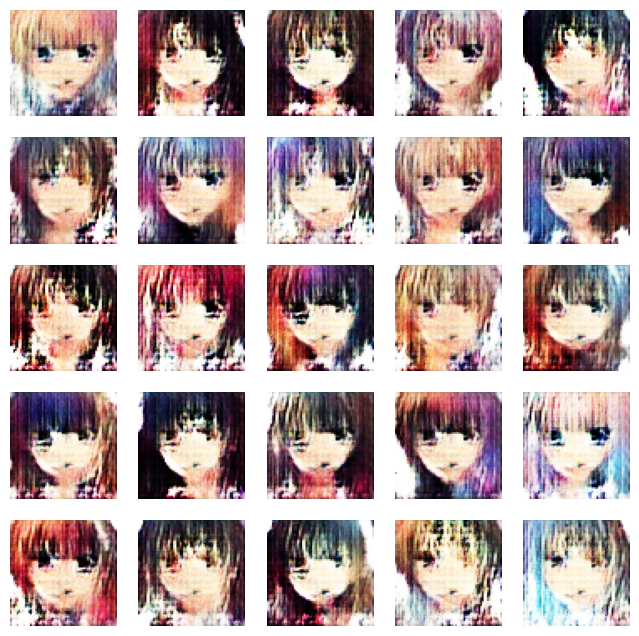

674/674 [==============================] - 48s 71ms/step - d_loss: 0.5719 - g_loss: 1.6219
Epoch 7/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.5968 - g_loss: 1.4953

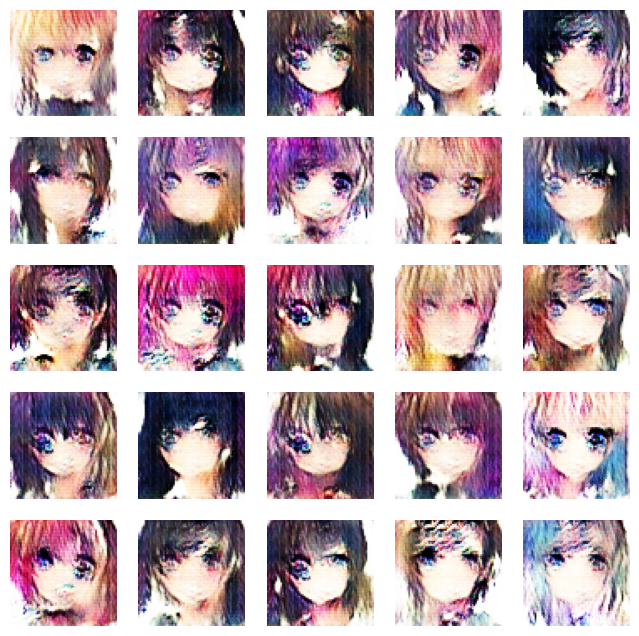

674/674 [==============================] - 48s 71ms/step - d_loss: 0.5970 - g_loss: 1.4953
Epoch 8/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.5952 - g_loss: 1.4002

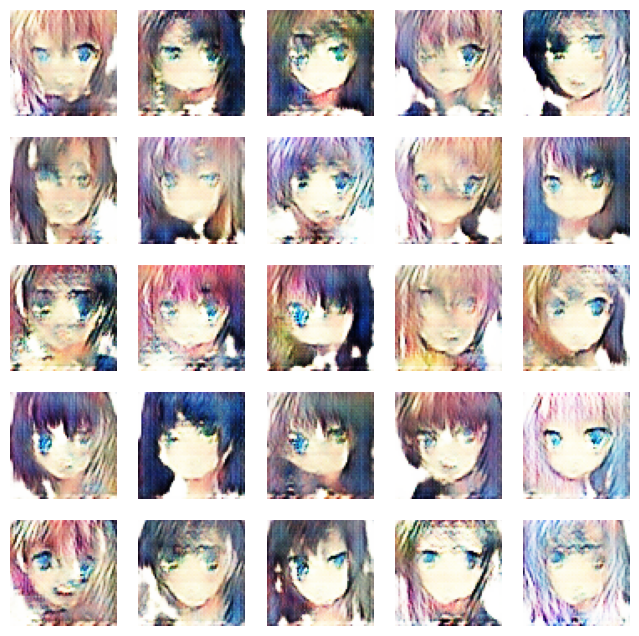

674/674 [==============================] - 48s 71ms/step - d_loss: 0.5953 - g_loss: 1.3997
Epoch 9/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.6363 - g_loss: 1.2513

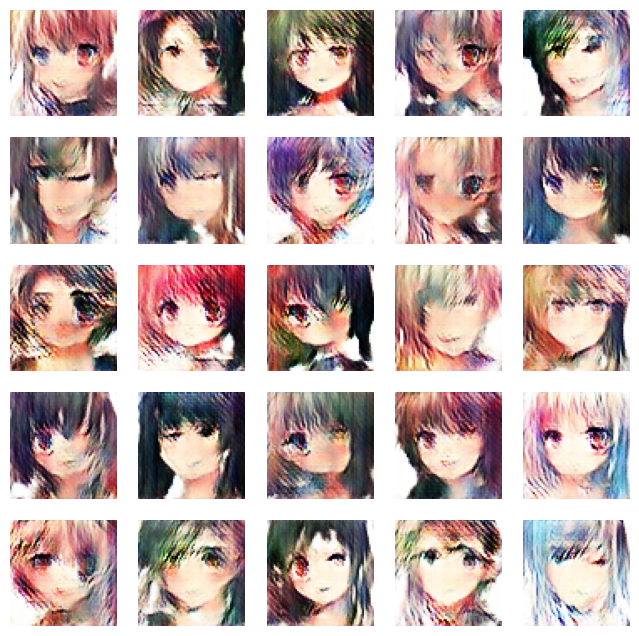

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6364 - g_loss: 1.2512
Epoch 10/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.6872 - g_loss: 1.0470

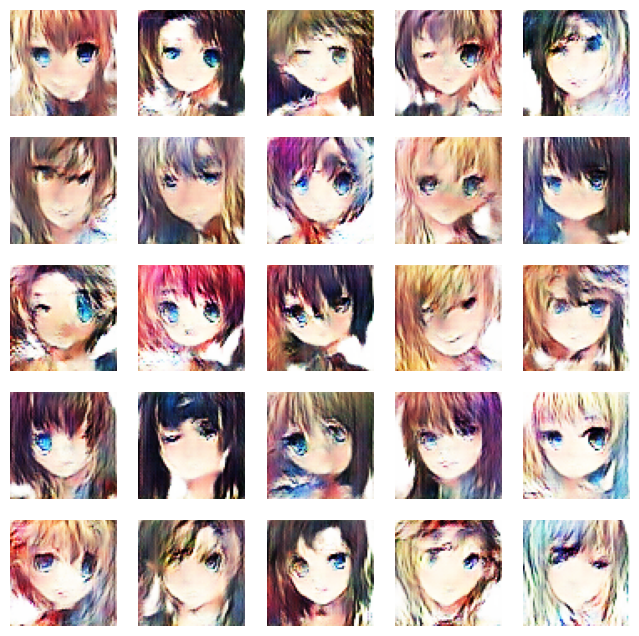

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6872 - g_loss: 1.0476
Epoch 11/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7007 - g_loss: 0.9705

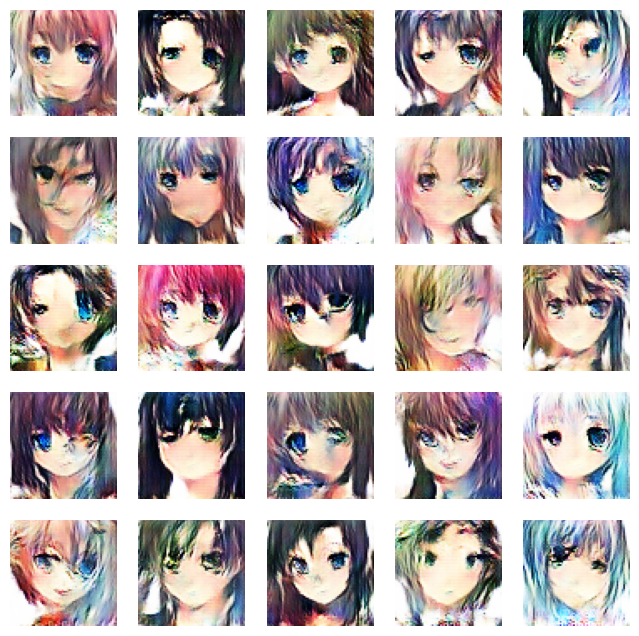

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7010 - g_loss: 0.9703
Epoch 12/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7190 - g_loss: 0.8889

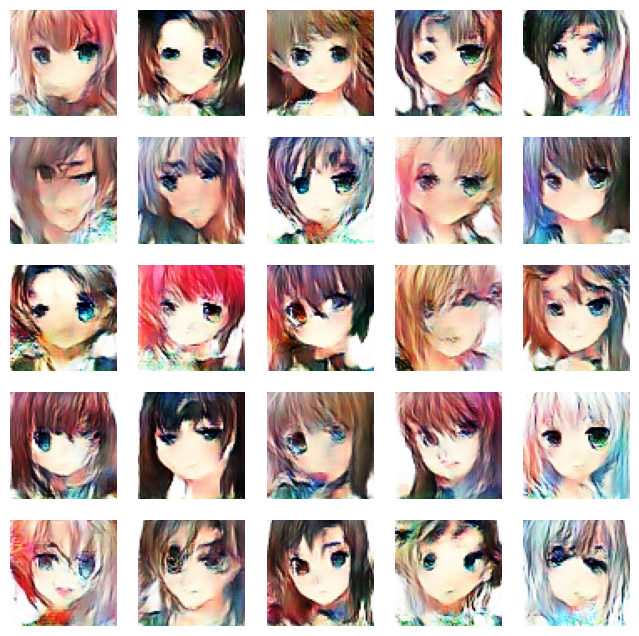

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7191 - g_loss: 0.8888
Epoch 13/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7129 - g_loss: 0.8634

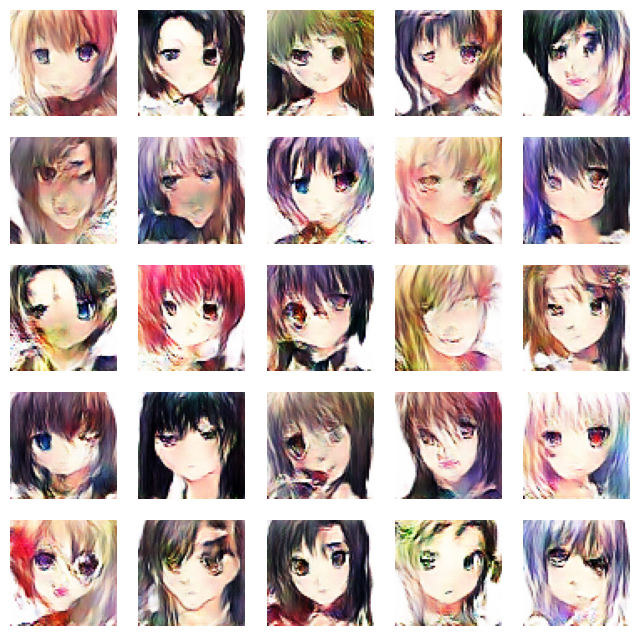

674/674 [==============================] - 47s 70ms/step - d_loss: 0.7128 - g_loss: 0.8633
Epoch 14/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7099 - g_loss: 0.8507

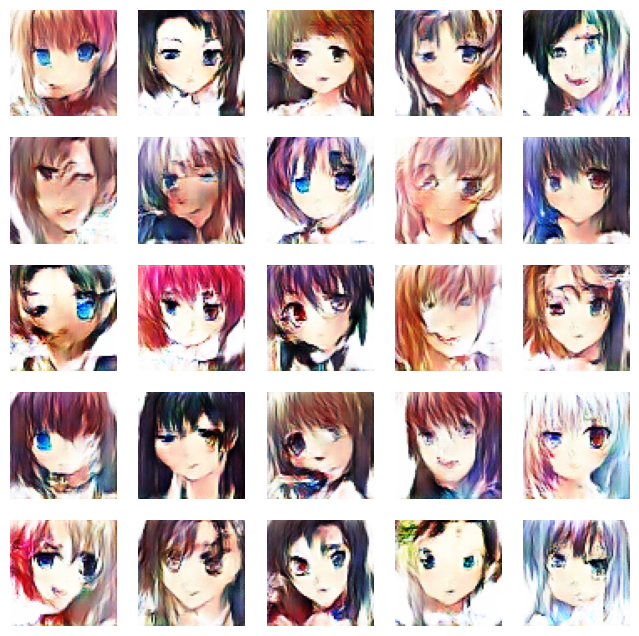

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7099 - g_loss: 0.8511
Epoch 15/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7093 - g_loss: 0.8249

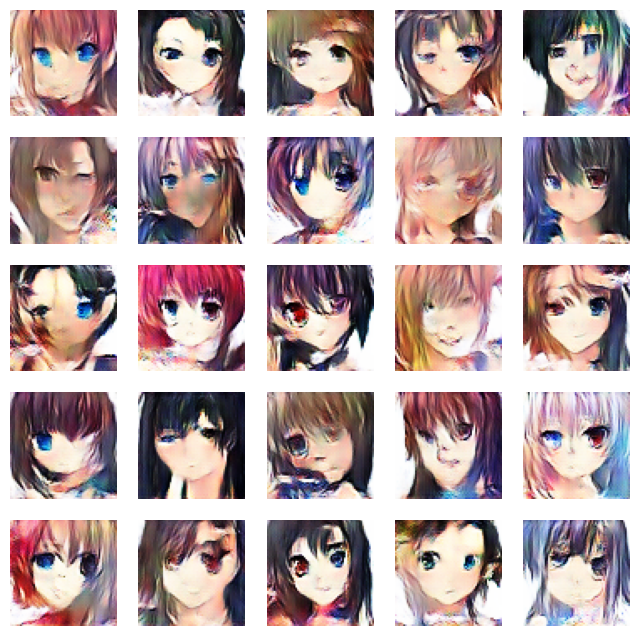

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7092 - g_loss: 0.8249
Epoch 16/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7058 - g_loss: 0.8130

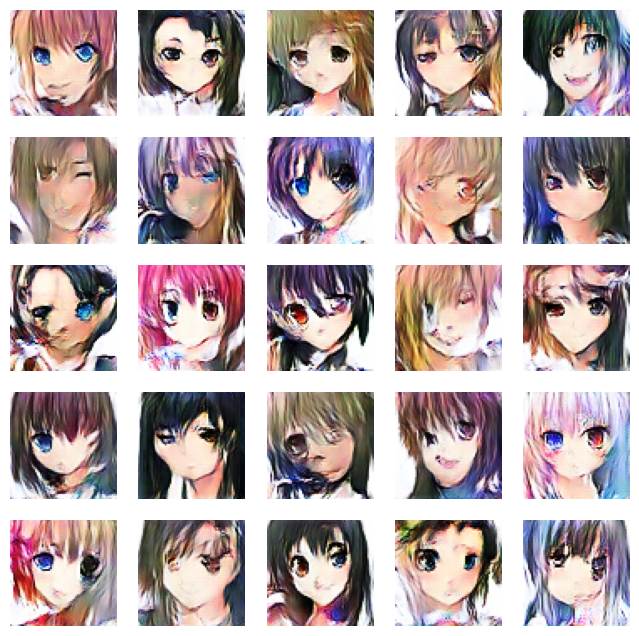

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7057 - g_loss: 0.8128
Epoch 17/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7045 - g_loss: 0.8004

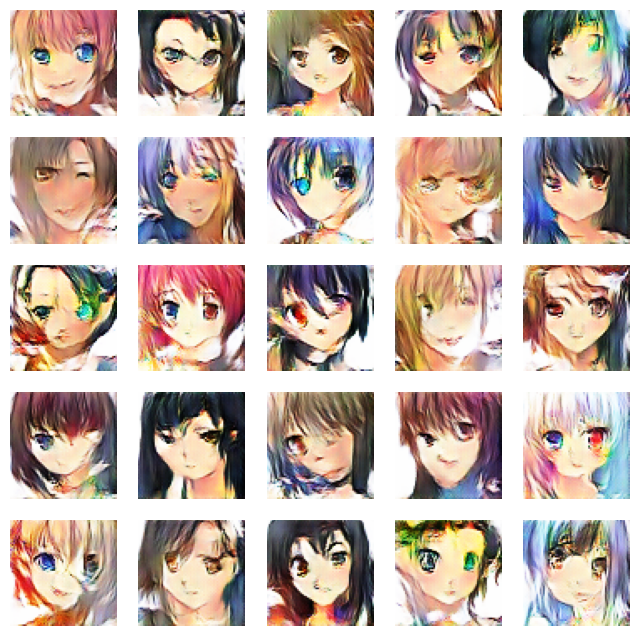

674/674 [==============================] - 47s 70ms/step - d_loss: 0.7043 - g_loss: 0.8003
Epoch 18/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7034 - g_loss: 0.7964

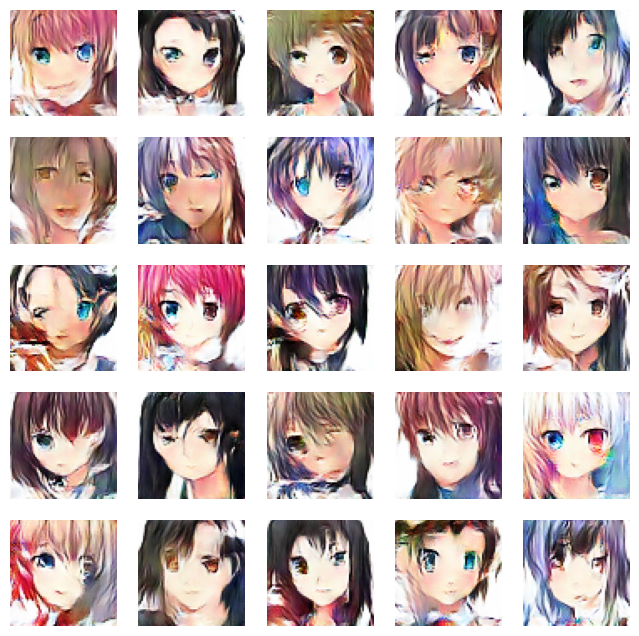

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7033 - g_loss: 0.7966
Epoch 19/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7029 - g_loss: 0.7886

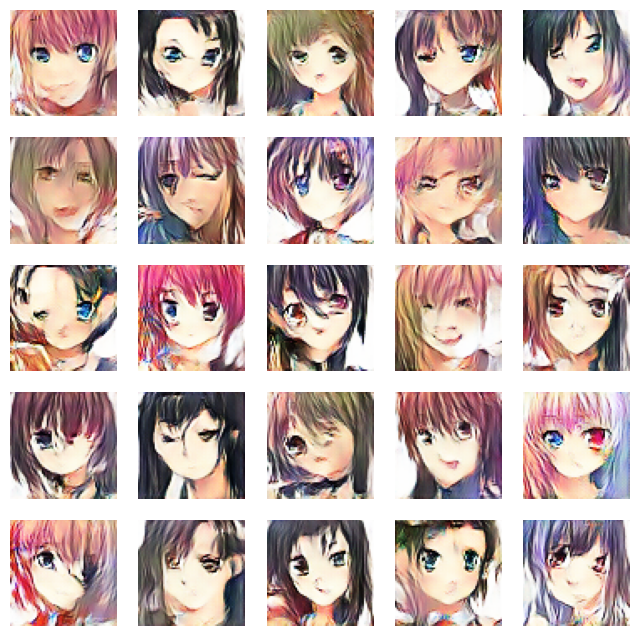

674/674 [==============================] - 47s 70ms/step - d_loss: 0.7029 - g_loss: 0.7886
Epoch 20/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.7014 - g_loss: 0.7798

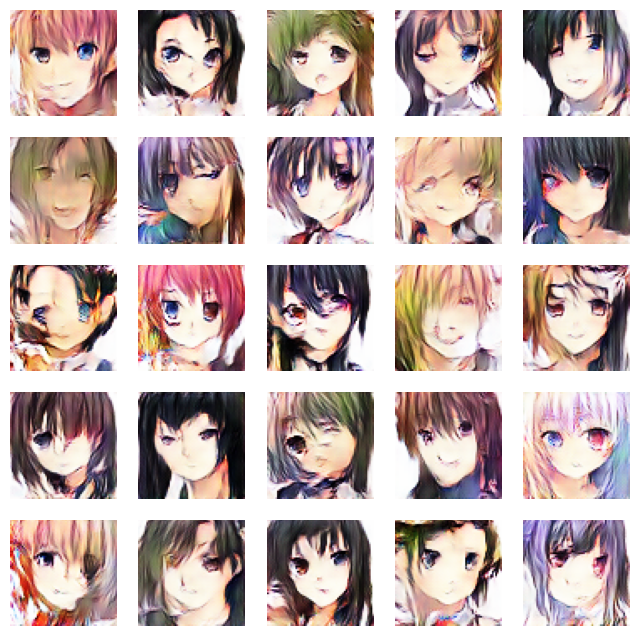

674/674 [==============================] - 48s 71ms/step - d_loss: 0.7014 - g_loss: 0.7798
Epoch 21/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.6985 - g_loss: 0.7844

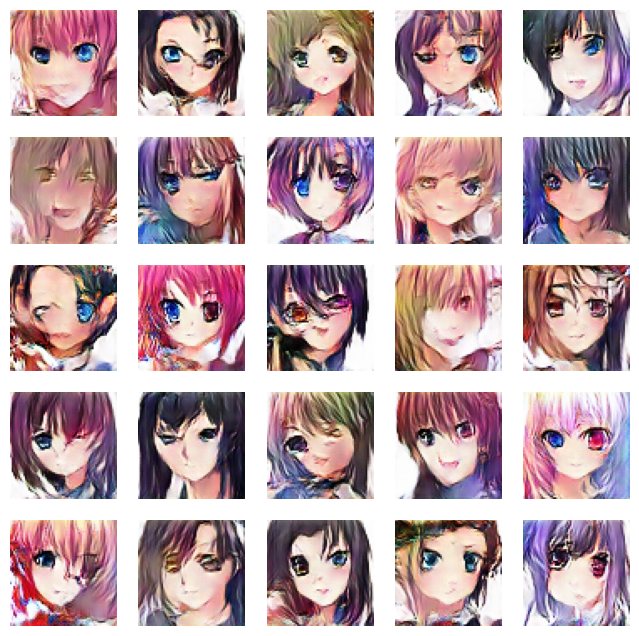

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6986 - g_loss: 0.7844
Epoch 22/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.6964 - g_loss: 0.7752

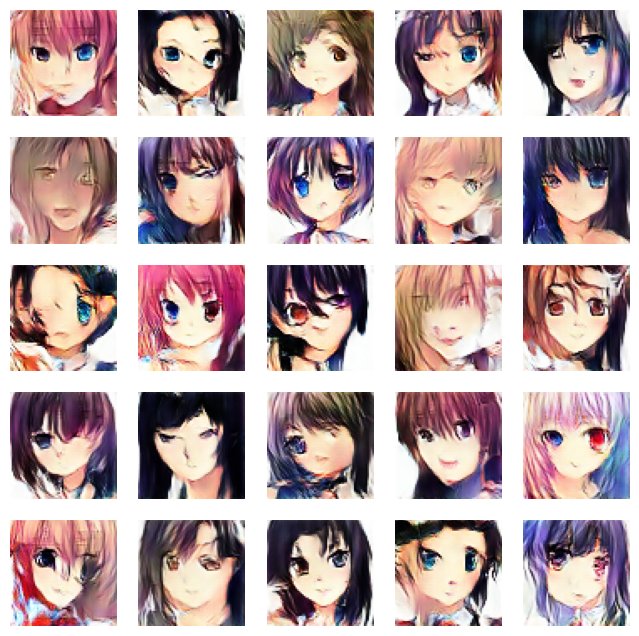

674/674 [==============================] - 47s 70ms/step - d_loss: 0.6964 - g_loss: 0.7753
Epoch 23/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.6951 - g_loss: 0.7762

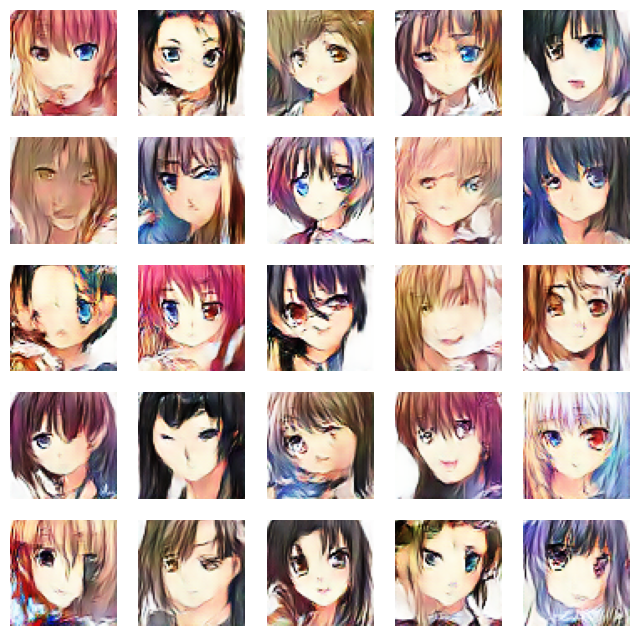

674/674 [==============================] - 47s 70ms/step - d_loss: 0.6951 - g_loss: 0.7763
Epoch 24/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.6916 - g_loss: 0.7811

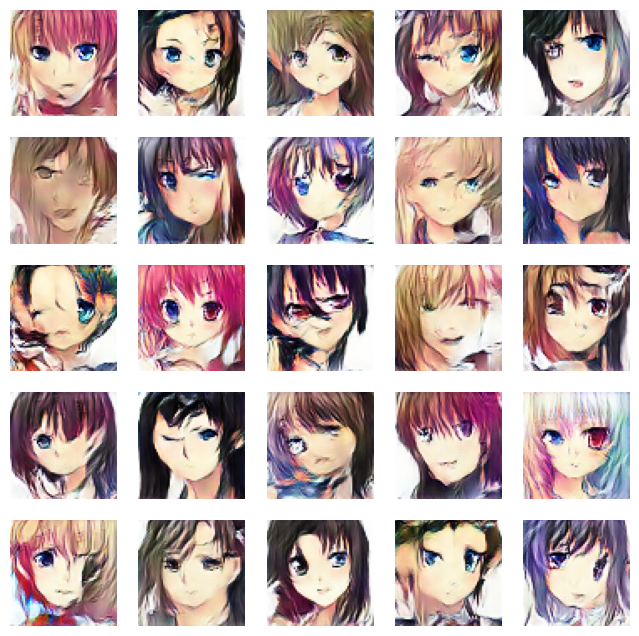

674/674 [==============================] - 48s 71ms/step - d_loss: 0.6916 - g_loss: 0.7811
Epoch 25/25
673/674 [============================>.] - ETA: 0s - d_loss: 0.6903 - g_loss: 0.7833

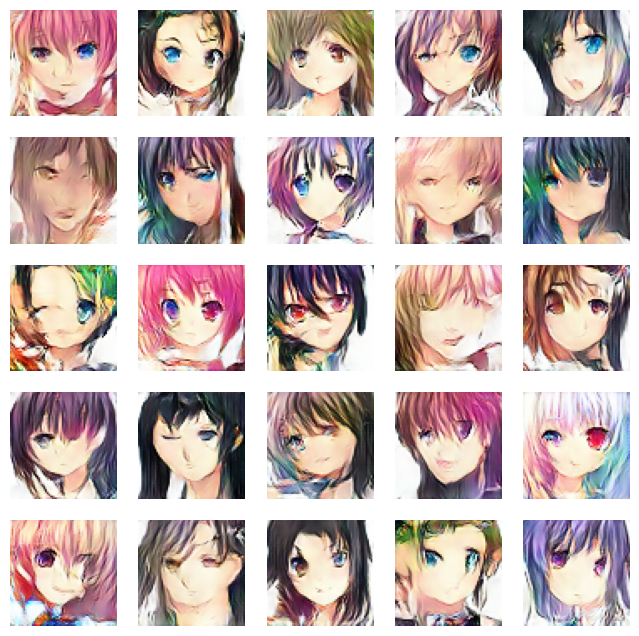

674/674 [==============================] - 47s 70ms/step - d_loss: 0.6903 - g_loss: 0.7834


In [ ]:
N_EPOCHS = 25
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

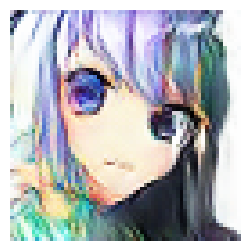

In [ ]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()